<a href="https://colab.research.google.com/github/Tendo15/Theater-booking-app2/blob/main/EDAMissingValues.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
import os
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
!pwd
import os
os.chdir('/content/drive/MyDrive/ColabNotebooks2024/Group Project')
!pwd

/content
/content/drive/MyDrive/ColabNotebooks2024/Group Project


In [3]:
import pandas as pd
dataset = pd.read_csv('./kaggle_sirio_libanes_ICU_Prediction copy.csv')

# 231 Variables, 1925 records

In [8]:
dataset.shape

(1925, 231)

In [7]:
dataset.head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,...,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,0
1,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,2-4,0
2,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4-6,0
3,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,NaN,NaN,NaN,NaN,-1.000000,-1.000000,6-12,0
4,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-0.238095,-0.818182,-0.389967,0.407558,-0.230462,0.096774,-0.242282,-0.814433,ABOVE_12,1


# Missingno Package to visualise missing values

<Axes: >

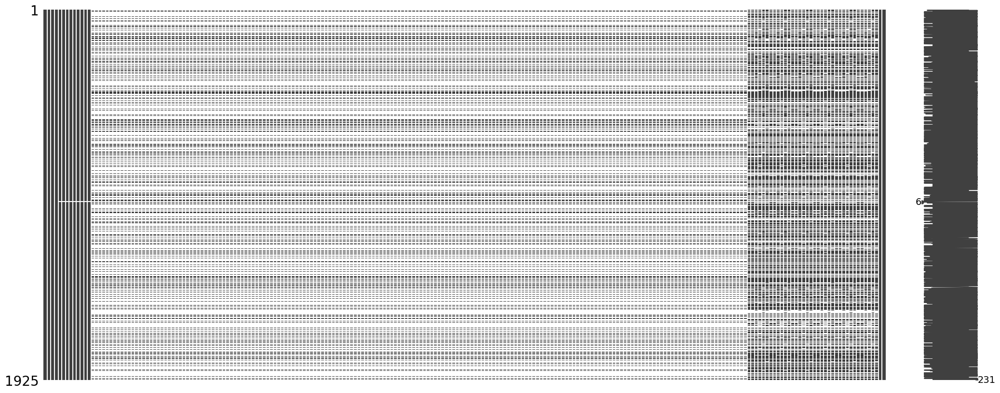

In [10]:
import missingno as msno  # Visualize missing values
%matplotlib inline
msno.matrix(dataset)

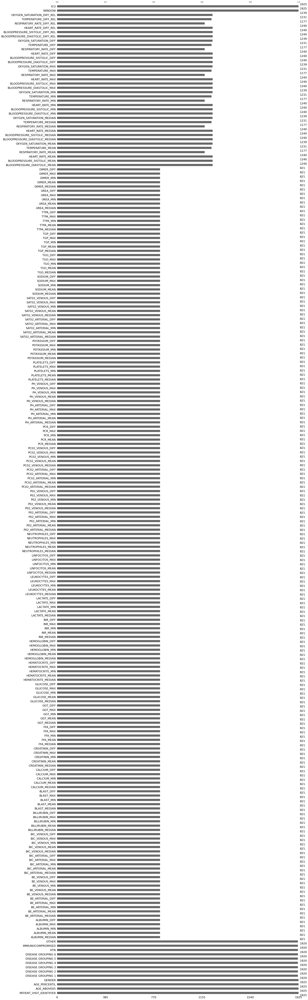

In [11]:
msno.bar(dataset);

#Observations: The 6 variables bellow DON'T HAVE missing values,. 1,925 recorded values
- ICU
- Window
- Gender
- Age percentage
- Age above 65
- Patient visit identifier


# Observations: The other 9 variables only have 5 missing values with a total of 1930 recorded values.

- Other
- Immunocompromised
- HTN
- Group 1-6

<Axes: >

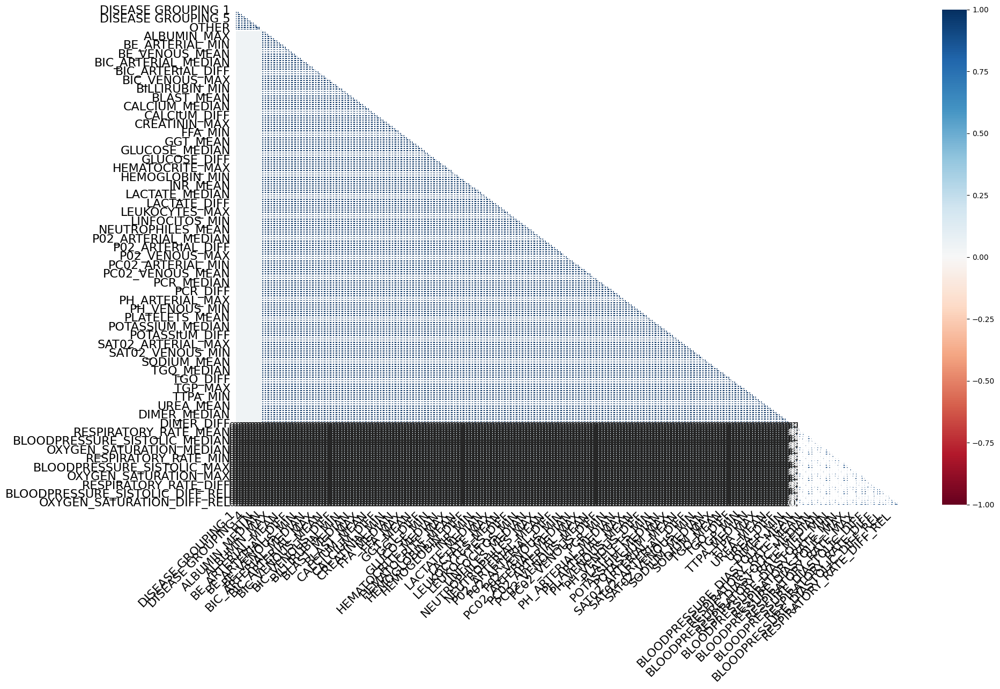

In [12]:
msno.heatmap(dataset)

#Import Data library: Data prep


In [14]:
!pip install dataprep

In [15]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
from dataprep.eda import plot, plot_missing

#Missing values:

stats of Variables with missing value decending order

In [16]:
dataset.isnull().sum().sort_values(ascending=False)

P02_VENOUS_MIN              1104
LEUKOCYTES_MAX              1104
PC02_VENOUS_MEAN            1104
PC02_VENOUS_MIN             1104
PC02_VENOUS_MAX             1104
                            ... 
PATIENT_VISIT_IDENTIFIER       0
AGE_ABOVE65                    0
GENDER                         0
AGE_PERCENTIL                  0
ICU                            0
Length: 231, dtype: int64

# Variabes, Total, NaN with missing values

- "In total, there are 225 variables with missing values"
- Only 6 out of 231 variables DON'T have missing values
-
NaN values = 223863


In [17]:
import matplotlib.pyplot as plt
print('NaN values =', dataset.isnull().sum().sum())
print("""""")

vars_with_missing = []

for feature in dataset.columns:
    missings = dataset[feature].isna().sum()

    if missings > 0 :
        vars_with_missing.append(feature)
        missings_perc = missings / dataset.shape[0]

        print('Variable {} has {} records ({:.2%}) with missing values.'.format(feature, missings, missings_perc))
print('In total, there are {} variables with missing values'.format(len(vars_with_missing)))

NaN values = 223863

Variable DISEASE GROUPING 1 has 5 records (0.26%) with missing values.
Variable DISEASE GROUPING 2 has 5 records (0.26%) with missing values.
Variable DISEASE GROUPING 3 has 5 records (0.26%) with missing values.
Variable DISEASE GROUPING 4 has 5 records (0.26%) with missing values.
Variable DISEASE GROUPING 5 has 5 records (0.26%) with missing values.
Variable DISEASE GROUPING 6 has 5 records (0.26%) with missing values.
Variable HTN has 5 records (0.26%) with missing values.
Variable IMMUNOCOMPROMISED has 5 records (0.26%) with missing values.
Variable OTHER has 5 records (0.26%) with missing values.
Variable ALBUMIN_MEDIAN has 1104 records (57.35%) with missing values.
Variable ALBUMIN_MEAN has 1104 records (57.35%) with missing values.
Variable ALBUMIN_MIN has 1104 records (57.35%) with missing values.
Variable ALBUMIN_MAX has 1104 records (57.35%) with missing values.
Variable ALBUMIN_DIFF has 1104 records (57.35%) with missing values.
Variable BE_ARTERIAL_MED

#Printing columns with the missing "mean" Values alone

Only 42 columns have mean values

In [20]:

# Create a list of all column names that contain MEAN
mean_columns = []
for column in dataset.columns:
    if "MEAN" in column:
        mean_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[mean_columns]

# Print the extracted columns
print(len(mean_columns))

42


In [21]:
dataset[mean_columns].shape

(1925, 42)

<Figure size 50000x600 with 0 Axes>

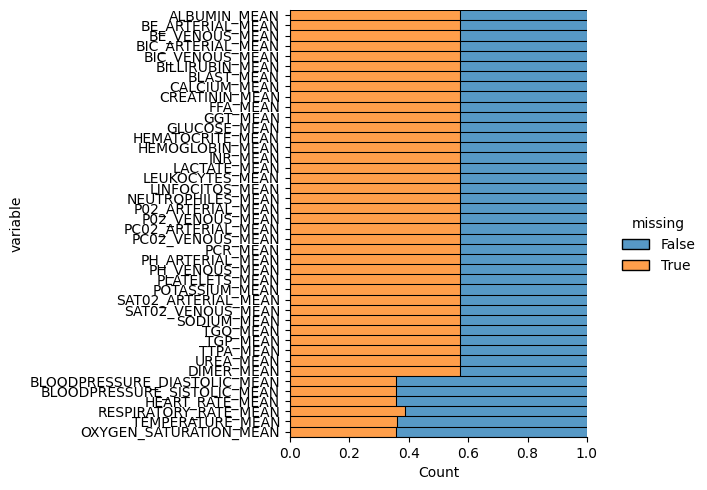

In [23]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[mean_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)

#Printing columns with the "median" Values alone

In [27]:
# Create a list of all column names that contain MEDIAN
median_columns = []
for column in dataset.columns:
    if "MEDIAN" in column:
        median_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[median_columns]

# Print the extracted columns
print(len(median_columns))

42


<Figure size 50000x600 with 0 Axes>

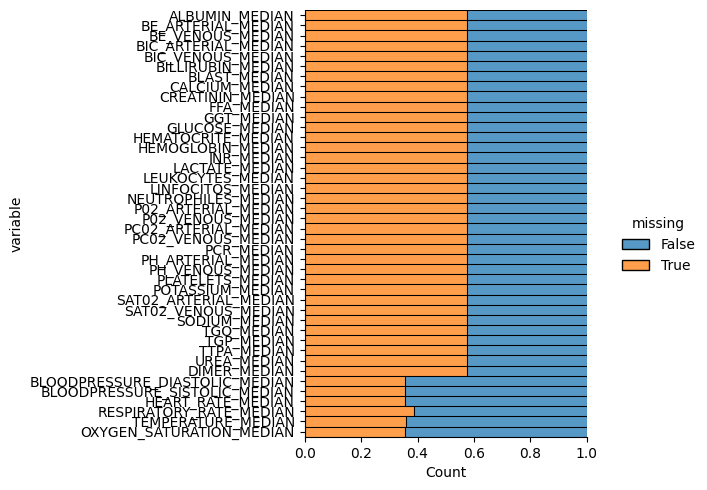

In [28]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[median_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)

#Plots of missing mean columns

In [29]:
from dataprep.eda import plot, plot_correlation

ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'



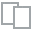
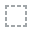
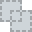
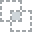
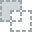
...
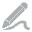
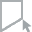
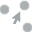
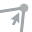
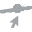

In [51]:
plot_missing(dataset[median_columns])

ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IAN'



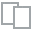
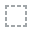
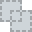
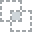
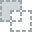
...
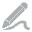
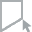
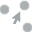
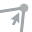
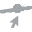

In [50]:
plot_missing(dataset[mean_columns])

#Plots of missing variables: Heart rate
 has 35.64% -67.53%

In [43]:

# Create a list of all column names that contain HEART_RATE
heart_rate_columns = []
for column in dataset.columns:
    if "HEART_RATE" in column:
        heart_rate_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[heart_rate_columns]

# Print the extracted columns
print(len(heart_rate_columns))

6


In [44]:
dataset[heart_rate_columns].shape

(1925, 6)

<Figure size 50000x600 with 0 Axes>

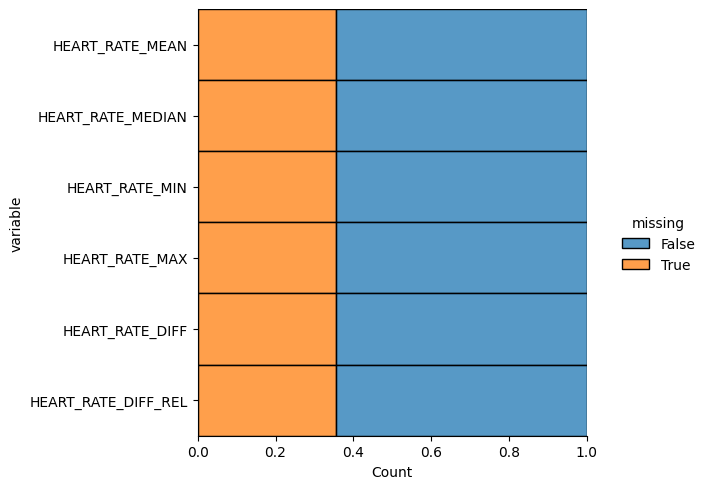

In [45]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[heart_rate_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


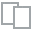
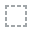
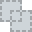
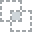
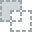
...
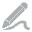
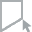
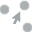
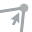
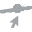

In [48]:
plot_missing(dataset[heart_rate_columns])

#Plots of missing values OXYGEN SATURATION

In [54]:
# Create a list of all column names that contain OXYGEN SATURATION
oxygen_saturation_columns = []
for column in dataset.columns:
    if "OXYGEN_SATURATION" in column:
        oxygen_saturation_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[ oxygen_saturation_columns]

# Print the extracted columns
print(len(oxygen_saturation_columns))

6


In [55]:
dataset[oxygen_saturation_columns].shape

(1925, 6)

<Figure size 50000x600 with 0 Axes>

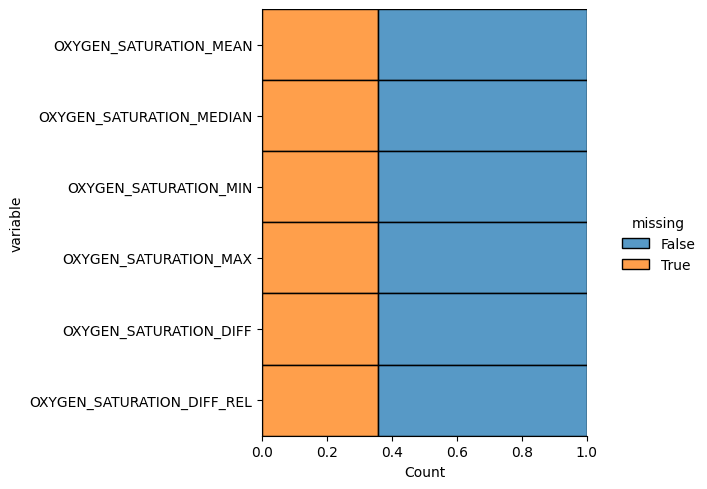

In [56]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[oxygen_saturation_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


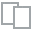
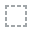
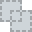
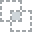
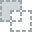
...
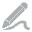
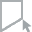
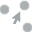
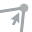
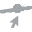

In [57]:
plot_missing(dataset[heart_rate_columns])

#Plots of missing values Tempreture
has 36.10% - 66.70% missing values

In [60]:
# Create a list of all column names that contain TEMPERATURE
temperature_columns = []
for column in dataset.columns:
    if "TEMPERATURE" in column:
        temperature_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[temperature_columns]

# Print the extracted columns
print(len(temperature_columns))

6


In [61]:
dataset[temperature_columns].shape

(1925, 6)

<Figure size 50000x600 with 0 Axes>

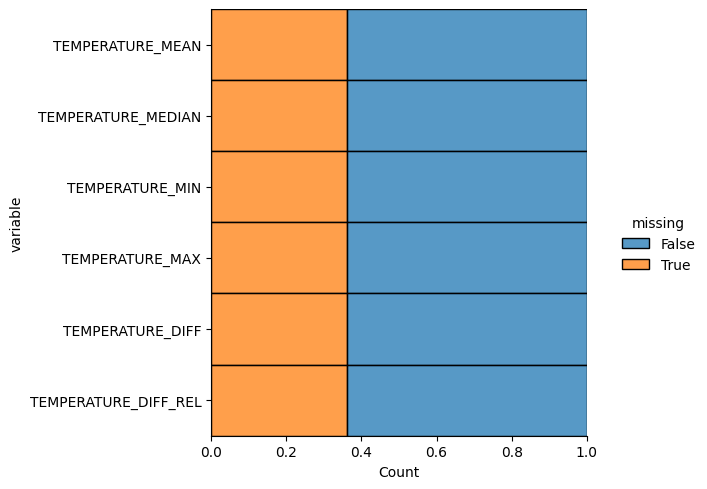

In [62]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[temperature_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


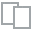
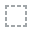
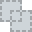
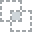
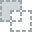
...
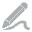
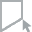
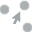
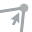
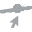

In [63]:
plot_missing(dataset[temperature_columns])

#Plots of missing values BLAST
has 99.64% - 100.00% of missing values

In [64]:
# Create a list of all column names that contain BLAST
blast_columns = []
for column in dataset.columns:
    if "BLAST" in column:
        blast_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[blast_columns]

# Print the extracted columns
print(len( blast_columns))

5


In [65]:
dataset[blast_columns].shape

(1925, 5)

<Figure size 50000x600 with 0 Axes>

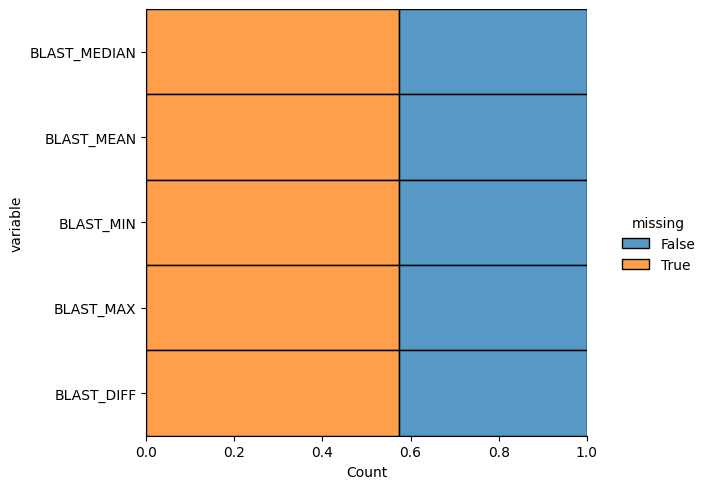

In [67]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[blast_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


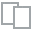
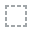
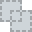
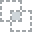
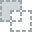
...
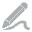
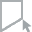
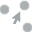
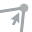
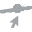

In [68]:
plot_missing(dataset[blast_columns])

#Plots of missing values BE ARTERIAL
HAS 96.10% - 100.00% missing values

In [71]:
# Create a list of all column names that contain  BE ARTERIAL
be_arterial_columns = []
for column in dataset.columns:
    if "BE_ARTERIAL" in column:
        be_arterial_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[be_arterial_columns]

# Print the extracted columns
print(len(be_arterial_columns))

5


In [72]:
dataset[be_arterial_columns].shape

(1925, 5)

<Figure size 50000x600 with 0 Axes>

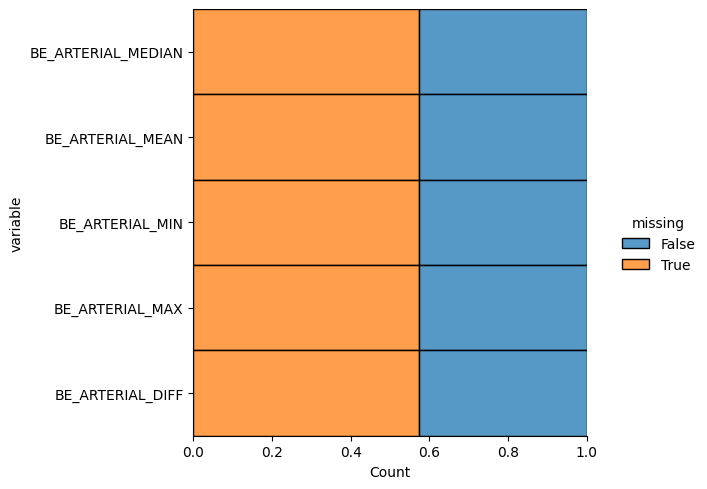

In [73]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[be_arterial_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


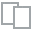
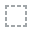
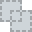
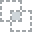
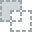
...
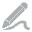
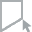
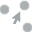
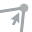
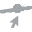

In [74]:
plot_missing(dataset[be_arterial_columns])

#Plots of missing values BE VENOUS
Has 87.64% - 100.00% missing values

In [75]:
# Create a list of all column names that contain BE VENOUS
be_venous_columns = []
for column in dataset.columns:
    if "BE_VENOUS" in column:
        be_venous_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[be_venous_columns]

# Print the extracted columns
print(len(be_venous_columns))

5


In [76]:
dataset[be_venous_columns].shape

(1925, 5)

<Figure size 50000x600 with 0 Axes>

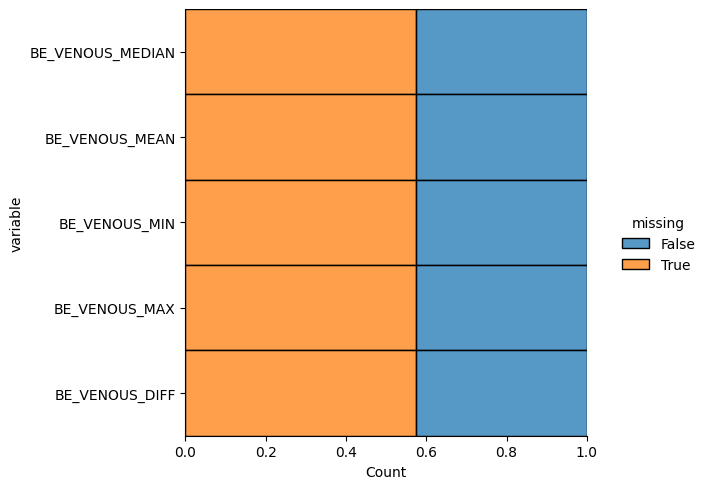

In [77]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[be_venous_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


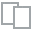
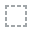
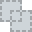
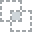
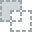
...
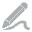
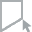
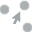
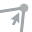
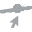

In [78]:
plot_missing(dataset[be_venous_columns])

#Plots of missing values POTASSIUM
Has 57.45% - 100% missing values

In [79]:
# Create a list of all column names that contain POTASSIUM
potassium_columns = []
for column in dataset.columns:
    if "POTASSIUM" in column:
        potassium_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[potassium_columns]

# Print the extracted columns
print(len(potassium_columns))

5


In [80]:
dataset[potassium_columns].shape

(1925, 5)

<Figure size 50000x600 with 0 Axes>

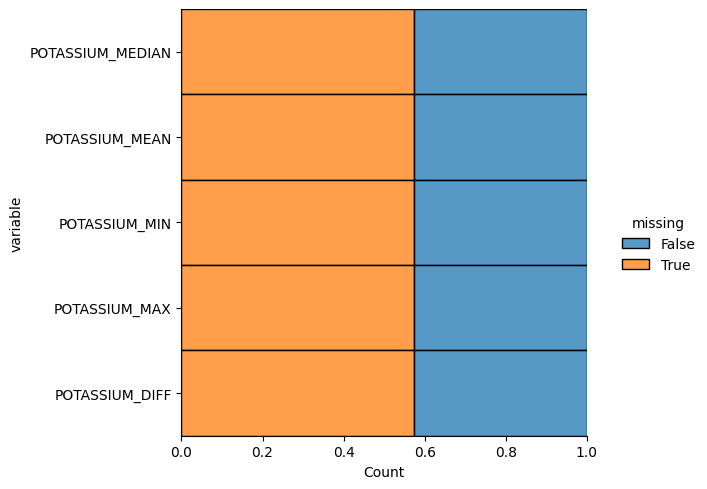

In [81]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[potassium_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


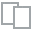
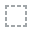
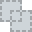
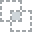
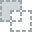
...
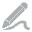
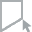
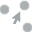
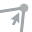
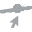

In [82]:
plot_missing(dataset[potassium_columns])

#Plots of missing values PCR
has 57% - 100% MISSING VALUES

In [86]:
from matplotlib.cbook import print_cycles
# Create a list of all column names that contain PCR
pcr_columns = []
for column in dataset.columns:
    if "PCR" in column:
        pcr_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[pcr_columns]

# Print the extracted columns
print(len(pcr_columns))

5


In [87]:
dataset[pcr_columns].shape

(1925, 5)

<Figure size 50000x600 with 0 Axes>

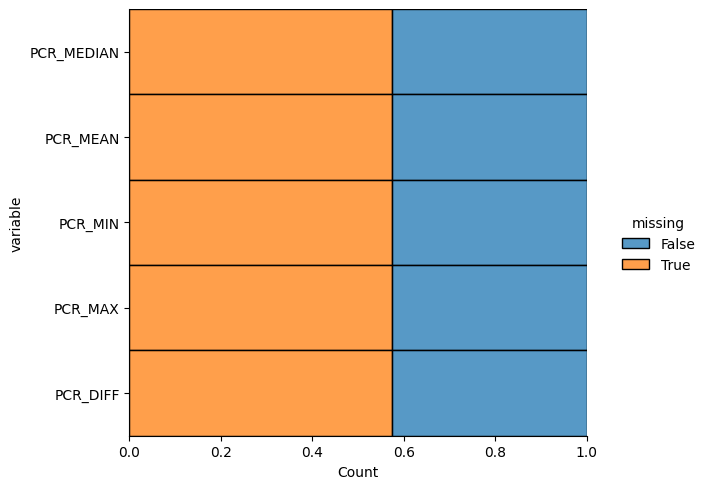

In [88]:
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[pcr_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)


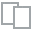
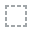
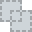
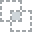
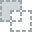
...
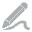
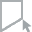
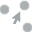
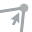
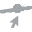

In [89]:
plot_missing(dataset[pcr_columns])

#MIssing value for differentce (DIFF)
mean and mid have 42 variables with missing values DIFF HAS 48. Diff must go !

In [90]:
from matplotlib.cbook import print_cycles
# Create a list of all column names that contain DIFF
diff_columns = []
for column in dataset.columns:
    if "DIFF" in column:
        diff_columns.append(column)

# Extract the columns that contain MIN, MAX, MEDIAN, MEAN, or DIFF
df_min_max_median_mean_diff = dataset[diff_columns]

# Print the extracted columns
print(len(diff_columns))

48


In [91]:
dataset[diff_columns].shape

(1925, 48)

<Figure size 50000x600 with 0 Axes>

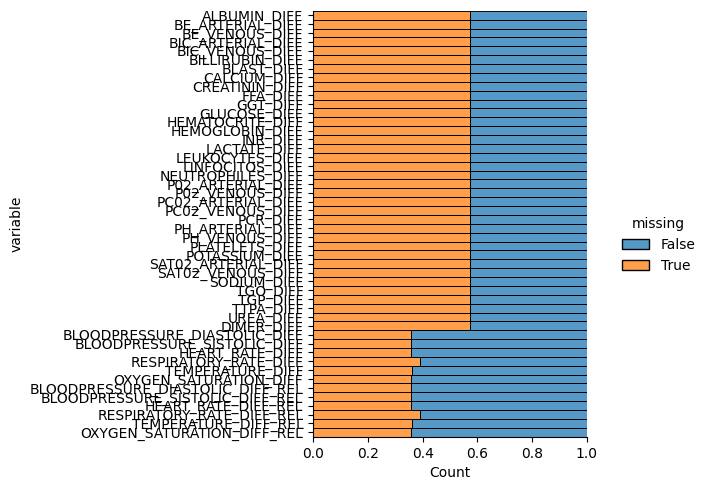

In [92]:
from bokeh.models.tools import difflib
import seaborn as sns
plt.figure(figsize=(500,6))
sns.displot(
    data=dataset[diff_columns].isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)

ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IFF', 'BLOODPRESSURE...REL'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...IFF', 'BLOODPRESSURE...REL'
ERROR:bokeh.core.validation.check:E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'BLOODPRESSURE...REL', 'BLOODPRESSURE...IFF'



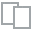
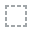
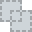
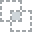
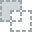
...
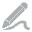
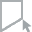
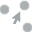
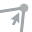
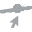

In [93]:
plot_missing(dataset[diff_columns])